<a href="https://colab.research.google.com/github/digvijay-m-s/Object-Detection-Detectron2/blob/main/Detectron2_Object_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Installing Libraries**

In [3]:
!pip install pyyaml==5.1
!pip install torch==1.7.1+cu101 torchvision==0.8.2+cu101 torchaudio==0.7.2 -f https://download.pytorch.org/whl/torch_stable.html

Looking in links: https://download.pytorch.org/whl/torch_stable.html


In [4]:
import glob
from google.colab.patches import cv2_imshow
import os
import ntpath
import numpy as np
import cv2
import random
import itertools
import pandas as pd
from tqdm import tqdm
import urllib
import json
import PIL.Image as Image
import tensorboard
import cv2
from google.colab.patches import cv2_imshow


import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc

%matplotlib inline
%config InlineBackend.figure_format='retina'



In [2]:
from tqdm import tqdm

In [5]:
import torch 
print(torch.__version__)
print(torch.cuda.is_available())

1.7.1+cu101
True


In [6]:
HAPPY_COLORS_PALETTE = ["#01BEFE", "#FFDD00", "#FF7D00", "#FF006D", "#ADFF02", "#8F00FF"]
sns.set_palette(sns.color_palette(HAPPY_COLORS_PALETTE))
rcParams['figure.figsize'] = 12, 8


In [7]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [8]:
###unzipping the images in images_df
!unzip drive/My\ Drive/data/images_df.zip -d images_df


Archive:  drive/My Drive/data/images_df.zip
replace images_df/images_df/db1.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: images_df/images_df/db1.jpg  
  inflating: images_df/images_df/db10.jpg  
  inflating: images_df/images_df/db100.jpg  
  inflating: images_df/images_df/db1000.jpg  
  inflating: images_df/images_df/db1001.jpg  
  inflating: images_df/images_df/db1002.jpg  
  inflating: images_df/images_df/db1003.jpg  
  inflating: images_df/images_df/db1004.jpg  
  inflating: images_df/images_df/db1005.jpg  
  inflating: images_df/images_df/db1006.jpg  
  inflating: images_df/images_df/db1007.jpg  
  inflating: images_df/images_df/db1008.jpg  
  inflating: images_df/images_df/db1009.jpg  
  inflating: images_df/images_df/db101.jpg  
  inflating: images_df/images_df/db1010.jpg  
  inflating: images_df/images_df/db1011.jpg  
  inflating: images_df/images_df/db1012.jpg  
  inflating: images_df/images_df/db1013.jpg  
  inflating: images_df/images_df/db1014.jpg  
  inflating:

In [9]:
## appending the data list with the file names
data = []

for filename in os.listdir("/content/images_df/images_df"):
    if filename.endswith("jpg"): 
        data.append(filename)
print(data)

['db2735.jpg', 'db29.jpg', 'db998.jpg', 'db3081.jpg', 'db499.jpg', 'db2018.jpg', 'db2538.jpg', 'db1352.jpg', 'db1113.jpg', 'db2929.jpg', 'db740.jpg', 'db2838.jpg', 'db1506.jpg', 'db611.jpg', 'db1078.jpg', 'db2443.jpg', 'db3082.jpg', 'db1374.jpg', 'db1957.jpg', 'db1530.jpg', 'db1672.jpg', 'db2906.jpg', 'db1934.jpg', 'db1551.jpg', 'db2358.jpg', 'db609.jpg', 'db2626.jpg', 'db724.jpg', 'db2821.jpg', 'db2606.jpg', 'db910.jpg', 'db1916.jpg', 'db1340.jpg', 'db2081.jpg', 'db502.jpg', 'db1856.jpg', 'db2356.jpg', 'db2341.jpg', 'db34.jpg', 'db528.jpg', 'db2723.jpg', 'db493.jpg', 'db1060.jpg', 'db559.jpg', 'db1945.jpg', 'db1625.jpg', 'db1865.jpg', 'db3043.jpg', 'db1141.jpg', 'db1330.jpg', 'db3037.jpg', 'db115.jpg', 'db1464.jpg', 'db1593.jpg', 'db2229.jpg', 'db526.jpg', 'db317.jpg', 'db343.jpg', 'db451.jpg', 'db2223.jpg', 'db2064.jpg', 'db1636.jpg', 'db3088.jpg', 'db1454.jpg', 'db1803.jpg', 'db722.jpg', 'db1532.jpg', 'db2082.jpg', 'db1051.jpg', 'db614.jpg', 'db85.jpg', 'db1968.jpg', 'db2230.jpg', '

In [10]:
len(data)  ## Number of total images 

3153

## IMPORTING bounding box csv file

In [11]:
#from google.colab import files

#uploaded = files.upload()


In [12]:
annote=pd.read_csv("/content/WebMarket_coco_gt_object.csv")

In [13]:
annote.head(10)

,image_name,x1,y1,x2,y2,class
0,db1.jpg,1105,919,1315,1127,object
1,db1.jpg,191,1242,398,1469,object
2,db1.jpg,1587,697,1906,761,object
3,db1.jpg,1541,442,1845,541,object
4,db1.jpg,1252,505,1398,761,object
5,db1.jpg,387,927,671,1112,object
6,db1.jpg,933,621,1085,766,object
7,db1.jpg,1325,932,1491,1137,object
8,db1.jpg,1091,592,1239,766,object
9,db1.jpg,778,646,924,763,object


In [14]:
annote.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118388 entries, 0 to 118387
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   image_name  118388 non-null  object
 1   x1          118388 non-null  int64 
 2   y1          118388 non-null  int64 
 3   x2          118388 non-null  int64 
 4   y2          118388 non-null  int64 
 5   class       118388 non-null  object
dtypes: int64(4), object(2)
memory usage: 5.4+ MB


In [15]:
annote.describe()

,x1,y1,x2,y2
count,118388.000000,118388.000000,118388.000000,118388.000000
mean,1107.766193,800.017797,1304.852747,1061.759756
std,688.966120,508.107534,689.925745,501.567340
min,0.000000,0.000000,0.000000,6.000000
25%,511.000000,346.000000,713.000000,641.000000
50%,1098.000000,807.000000,1303.000000,1072.000000
75%,1687.000000,1236.000000,1887.000000,1501.000000
max,2590.000000,1969.000000,2639.000000,2260.000000


In [16]:
annote['image_name'].value_counts()

db1849.jpg    264
db98.jpg      230
db89.jpg      199
db1850.jpg    192
db92.jpg      180
             ... 
db2069.jpg      2
db412.jpg       2
db3048.jpg      2
db2066.jpg      2
db413.jpg       1
Name: image_name, Length: 3151, dtype: int64

In [17]:
print(annote['image_name'].value_counts().max())
print(annote['image_name'].value_counts().min())

264
1


In [18]:
annote['class'].value_counts()

object    118388
Name: class, dtype: int64

In [19]:
annote['image_name'].nunique()

3151

number of images are matching #3151

## **Preparing Dataset**

In [20]:
annote['image_name']

0            db1.jpg
1            db1.jpg
2            db1.jpg
3            db1.jpg
4            db1.jpg
             ...    
118383    db2700.jpg
118384    db2700.jpg
118385    db2700.jpg
118386    db2700.jpg
118387    db2700.jpg
Name: image_name, Length: 118388, dtype: object

In [21]:
## check random images are present or not
if "db300.jpg" in data:

  print(True)
else:
  print(False) 



True


In [22]:
dataset = pd.DataFrame()

try:
  for img_name in data:
    temp_df = annote[annote['image_name'] == img_name]
    
    temp_df['file_path'] = os.path.join('images_df/images_df', img_name)
    dataset = pd.concat([dataset, temp_df])

except:
  print("file not found")
print(dataset.head())


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


       image_name    x1   y1  ...    y2   class                       file_path
15634  db2735.jpg  2377  868  ...  1118  object  images_df/images_df/db2735.jpg
15635  db2735.jpg  1562  309  ...   657  object  images_df/images_df/db2735.jpg
15636  db2735.jpg  2125  831  ...  1110  object  images_df/images_df/db2735.jpg
15637  db2735.jpg  1367  880  ...  1138  object  images_df/images_df/db2735.jpg
15638  db2735.jpg  2082  307  ...   481  object  images_df/images_df/db2735.jpg

[5 rows x 7 columns]


In [23]:
dataset.columns

Index(['image_name', 'x1', 'y1', 'x2', 'y2', 'class', 'file_path'], dtype='object')

In [24]:
dataset.shape

(118388, 7)

In [25]:
dataset.head()

,image_name,x1,y1,x2,y2,class,file_path
15634,db2735.jpg,2377,868,2534,1118,object,images_df/images_df/db2735.jpg
15635,db2735.jpg,1562,309,1722,657,object,images_df/images_df/db2735.jpg
15636,db2735.jpg,2125,831,2263,1110,object,images_df/images_df/db2735.jpg
15637,db2735.jpg,1367,880,1513,1138,object,images_df/images_df/db2735.jpg
15638,db2735.jpg,2082,307,2223,481,object,images_df/images_df/db2735.jpg


In [26]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 118388 entries, 15634 to 95648
Data columns (total 7 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   image_name  118388 non-null  object
 1   x1          118388 non-null  int64 
 2   y1          118388 non-null  int64 
 3   x2          118388 non-null  int64 
 4   y2          118388 non-null  int64 
 5   class       118388 non-null  object
 6   file_path   118388 non-null  object
dtypes: int64(4), object(3)
memory usage: 7.2+ MB


In [27]:
dataset.iloc[1]

##checking right match for  image_name and file_path randomly

image_name                        db2735.jpg
x1                                      1562
y1                                       309
x2                                      1722
y2                                       657
class                                 object
file_path     images_df/images_df/db2735.jpg
Name: 15635, dtype: object

## **Installing detectron**

In [28]:
### make sure the detectron is torch version 1.7 as we installed torch above of version 1.7

!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html


#Import Detectron2 and Run Inferencing

In [30]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data import build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.structures import BoxMode





In [31]:
  os.makedirs('objects', exist_ok = True)

In [32]:
unique_img = dataset.image_name.unique()

In [33]:
dataset = dataset.rename(columns=  {'class' : 'class_name'})

In [34]:
train_files = set(np.random.choice(unique_img, int(len(unique_img) * 0.90), replace=False))
train_df = dataset[dataset.image_name.isin(train_files)]
test_df = dataset[~dataset.image_name.isin(train_files)]

In [35]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 106375 entries, 15634 to 95648
Data columns (total 7 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   image_name  106375 non-null  object
 1   x1          106375 non-null  int64 
 2   y1          106375 non-null  int64 
 3   x2          106375 non-null  int64 
 4   y2          106375 non-null  int64 
 5   class_name  106375 non-null  object
 6   file_path   106375 non-null  object
dtypes: int64(4), object(3)
memory usage: 6.5+ MB


In [36]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12013 entries, 8358 to 96304
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image_name  12013 non-null  object
 1   x1          12013 non-null  int64 
 2   y1          12013 non-null  int64 
 3   x2          12013 non-null  int64 
 4   y2          12013 non-null  int64 
 5   class_name  12013 non-null  object
 6   file_path   12013 non-null  object
dtypes: int64(4), object(3)
memory usage: 750.8+ KB


In [37]:
classes = dataset.class_name.unique().tolist()

In [38]:
def create_dataset_dicts(df, classes):
  dataset_dicts = []
  for image_id, img_name in enumerate(df.image_name.unique()):

    record = {}

    image_df = df[df.image_name == img_name]

    record["file_name"] = image_df.file_path.values[0]
    record["image_id"] = image_id
    record["height"], record["width"] = cv2.imread(image_df.file_path.values[0]).shape[:2]

    objs = []
    for _, row in image_df.iterrows():

      x1 = int(row.x1)
      y1 = int(row.y1)
      x2 = int(row.x2)
      y2 = int(row.y2)

      poly = [
          (x1, y1), (x2, y1), 
          (x2, y2), (x1, y2)
      ]
      poly = list(itertools.chain.from_iterable(poly))

      obj = {
        "bbox": [x1, y1, x2, y2],
        "bbox_mode": BoxMode.XYXY_ABS,
        "segmentation": [poly],
        "category_id": classes.index(row.class_name),
      }
      objs.append(obj)

    record["annotations"] = objs
    dataset_dicts.append(record)
  return dataset_dicts

In [39]:
for d in ["train", "val"]:
  DatasetCatalog.register("objects_" + d, lambda d=d: create_dataset_dicts(train_df if d == "train" else test_df, classes))
  MetadataCatalog.get("objects_" + d).set(thing_classes=classes)

statement_metadata = MetadataCatalog.get("objects_train")

## Training set visualization

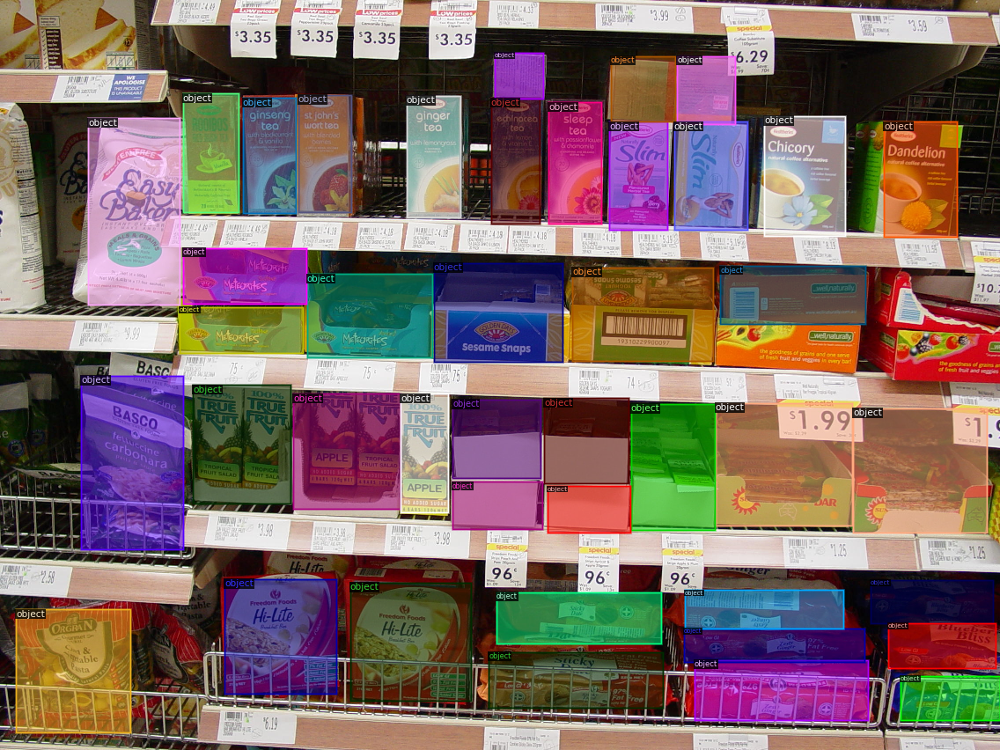

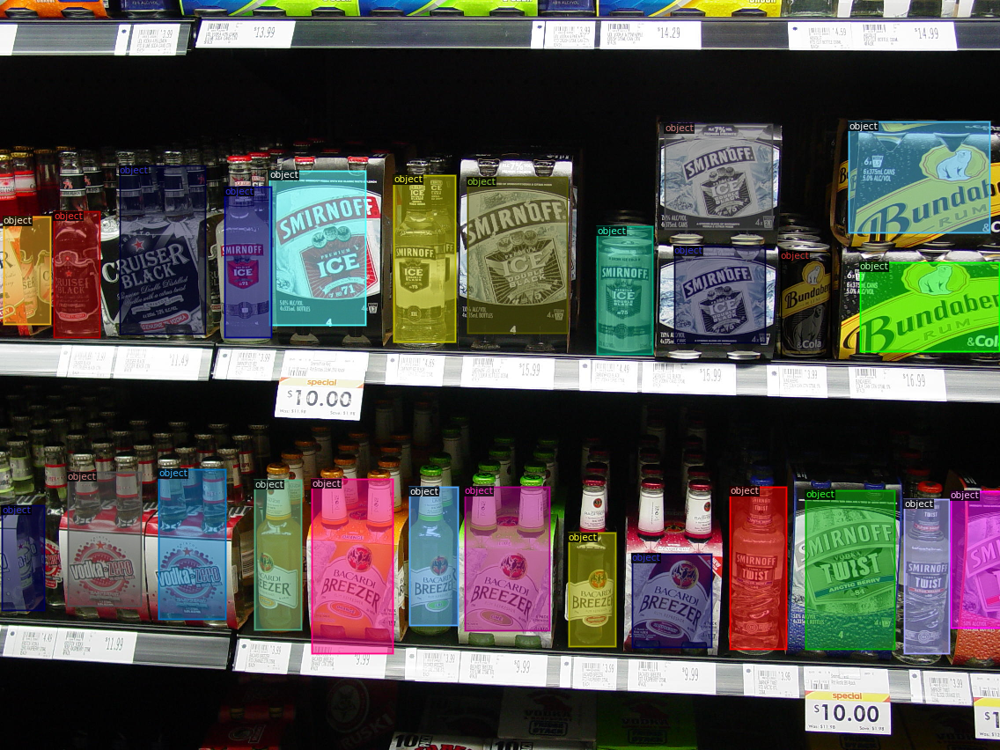

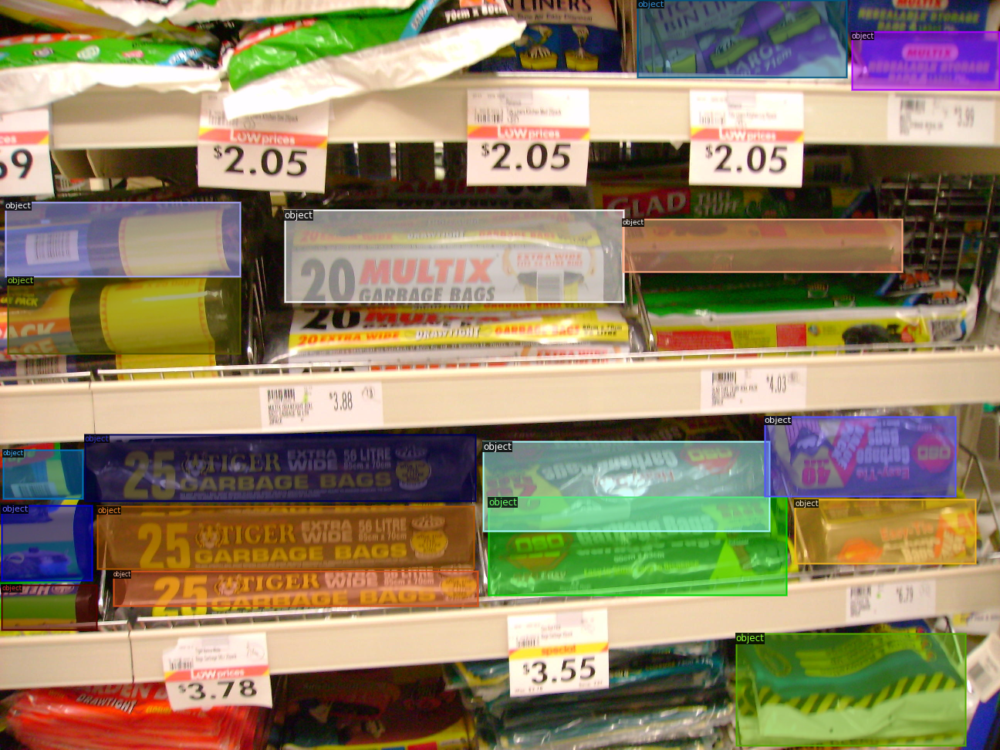

In [40]:
### this is how the training data looks like 


dataset_dicts = create_dataset_dicts(train_df[:300], classes)
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=statement_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

    ### this is how the training dataset looks like

In [41]:


class CocoTrainer(DefaultTrainer):
  
  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

## Model building and training

In [42]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("objects_train",)
cfg.DATASETS.TEST = ("objects_val",)
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")  
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.001 
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 2000   
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128  
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  
cfg.TEST.EVAL_PERIOD = 500
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[02/17 10:03:34 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_2d9806.pkl: 431MB [00:09, 44.6MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[02/17 10:07:29 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:363: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:363: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:363: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python

[02/17 10:08:36 d2.utils.events]:  eta: 1:46:30  iter: 19  total_loss: 2.839  loss_cls: 0.6899  loss_box_reg: 0.7127  loss_mask: 0.703  loss_rpn_cls: 0.5628  loss_rpn_loc: 0.1735  time: 3.2198  data_time: 0.0807  lr: 1.931e-06  max_mem: 5323M
[02/17 10:09:43 d2.utils.events]:  eta: 1:47:57  iter: 39  total_loss: 2.617  loss_cls: 0.6936  loss_box_reg: 0.6956  loss_mask: 0.6954  loss_rpn_cls: 0.2797  loss_rpn_loc: 0.1802  time: 3.2995  data_time: 0.0078  lr: 2.911e-06  max_mem: 5323M
[02/17 10:10:52 d2.utils.events]:  eta: 1:47:42  iter: 59  total_loss: 2.496  loss_cls: 0.679  loss_box_reg: 0.7257  loss_mask: 0.6847  loss_rpn_cls: 0.2967  loss_rpn_loc: 0.162  time: 3.3432  data_time: 0.0069  lr: 3.891e-06  max_mem: 5323M
[02/17 10:12:01 d2.utils.events]:  eta: 1:47:12  iter: 79  total_loss: 2.646  loss_cls: 0.6562  loss_box_reg: 0.7667  loss_mask: 0.67  loss_rpn_cls: 0.4081  loss_rpn_loc: 0.1798  time: 3.3710  data_time: 0.0076  lr: 4.871e-06  max_mem: 5323M
[02/17 10:13:05 d2.utils.even

In [1]:
"""%load_ext tensorboard
%tensorboard --logdir output"""

'%load_ext tensorboard\n%tensorboard --logdir output'

# Prediction on Test dataset

In [44]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

#Visualizer

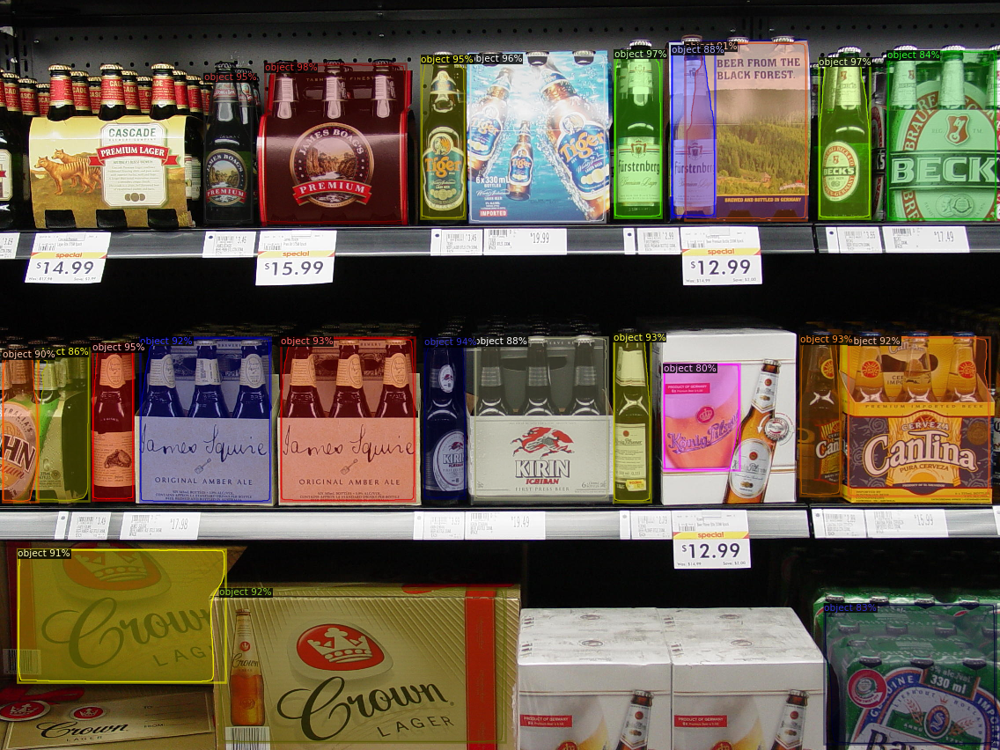

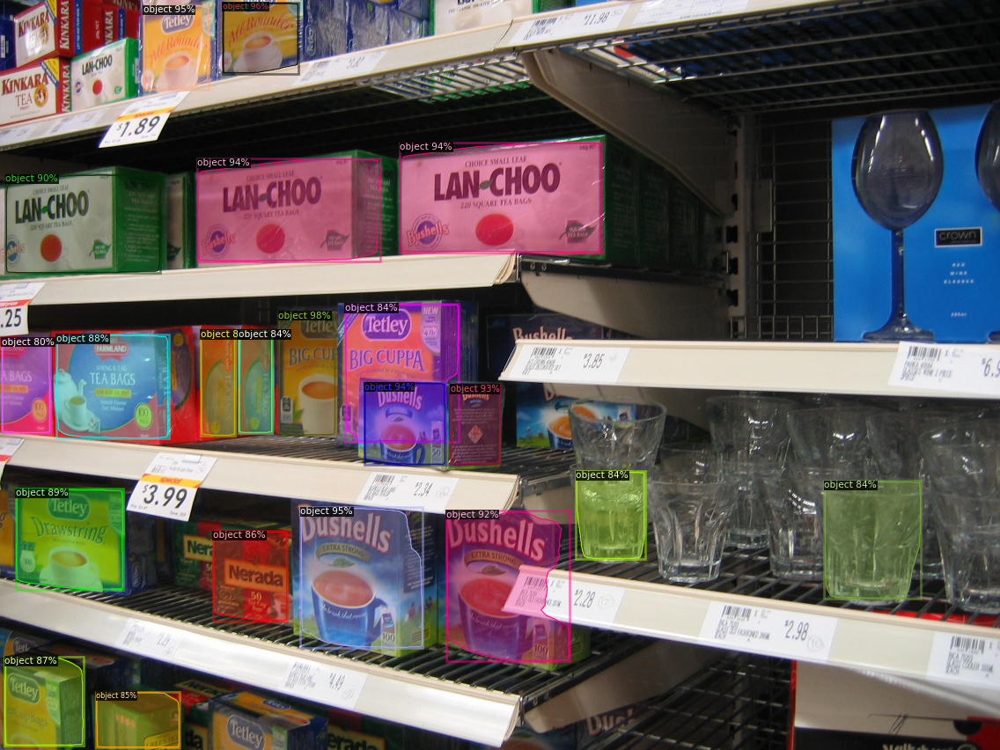

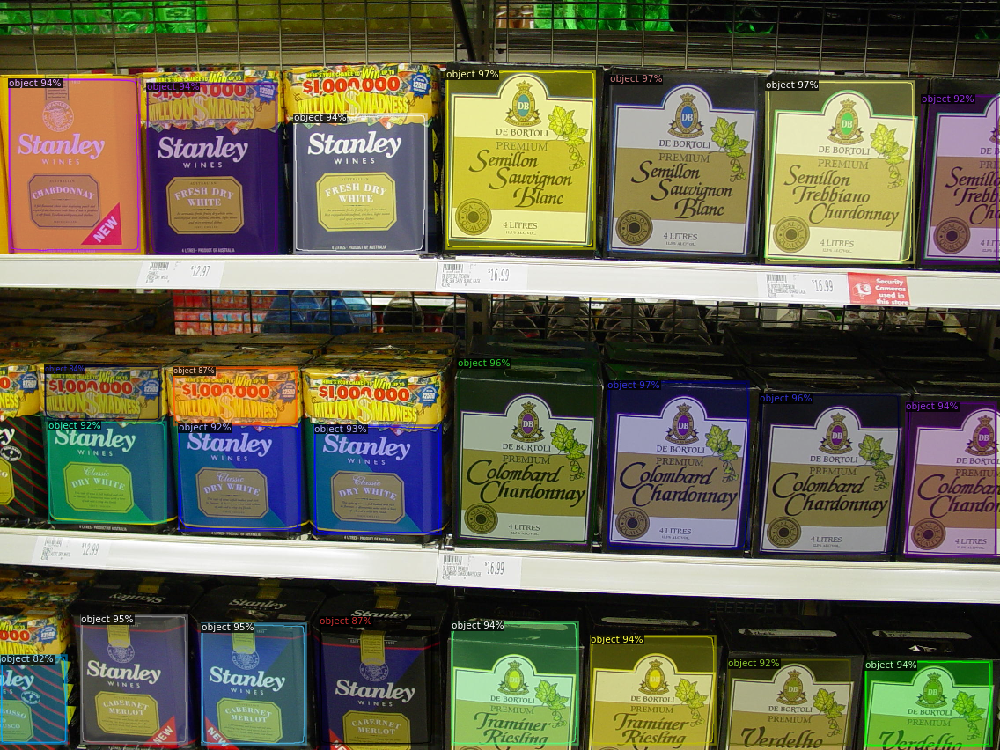

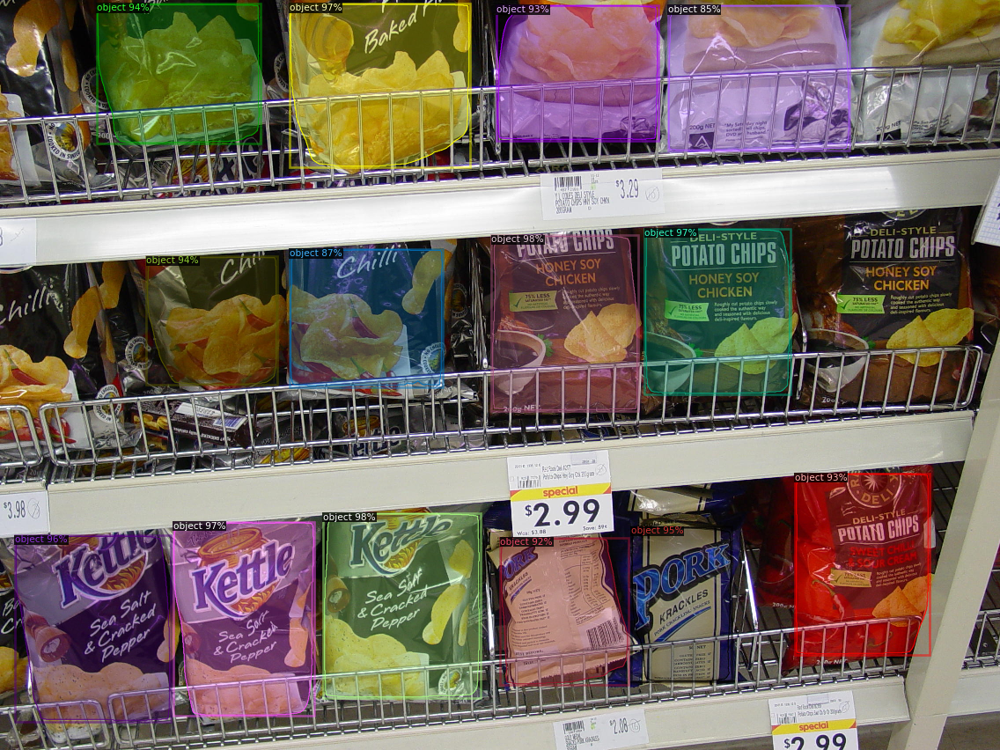

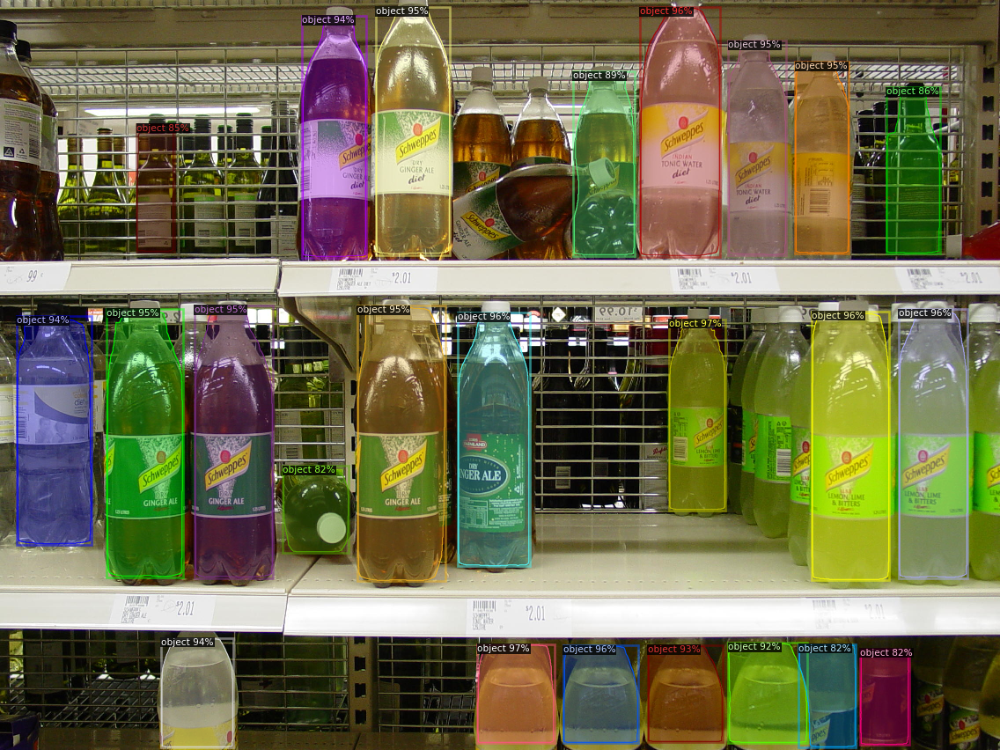

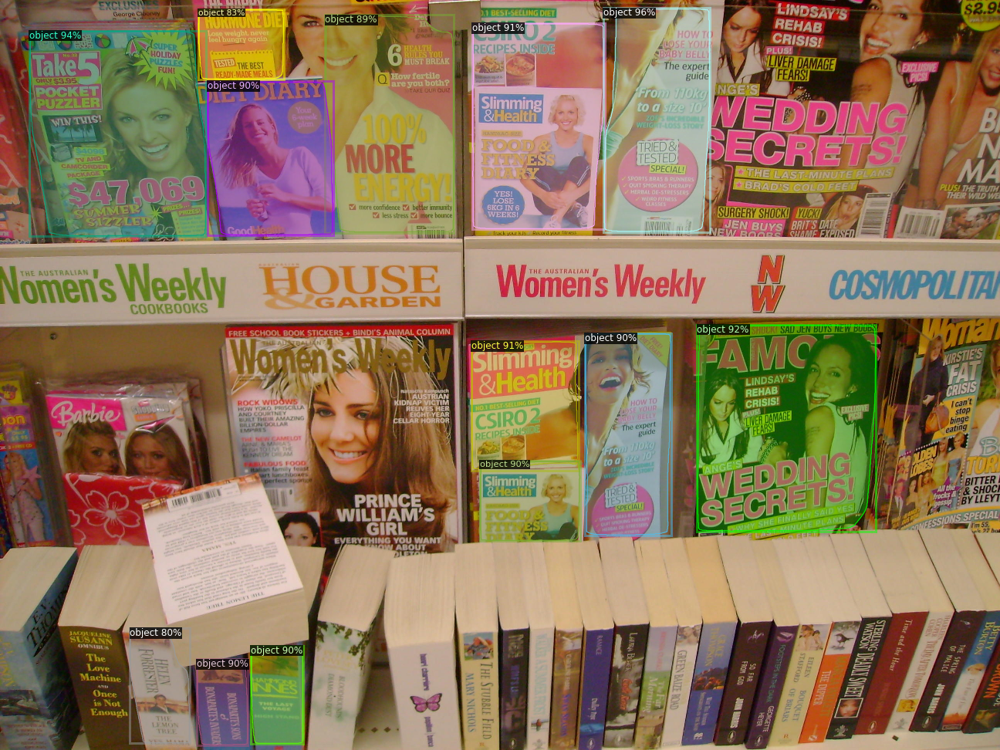

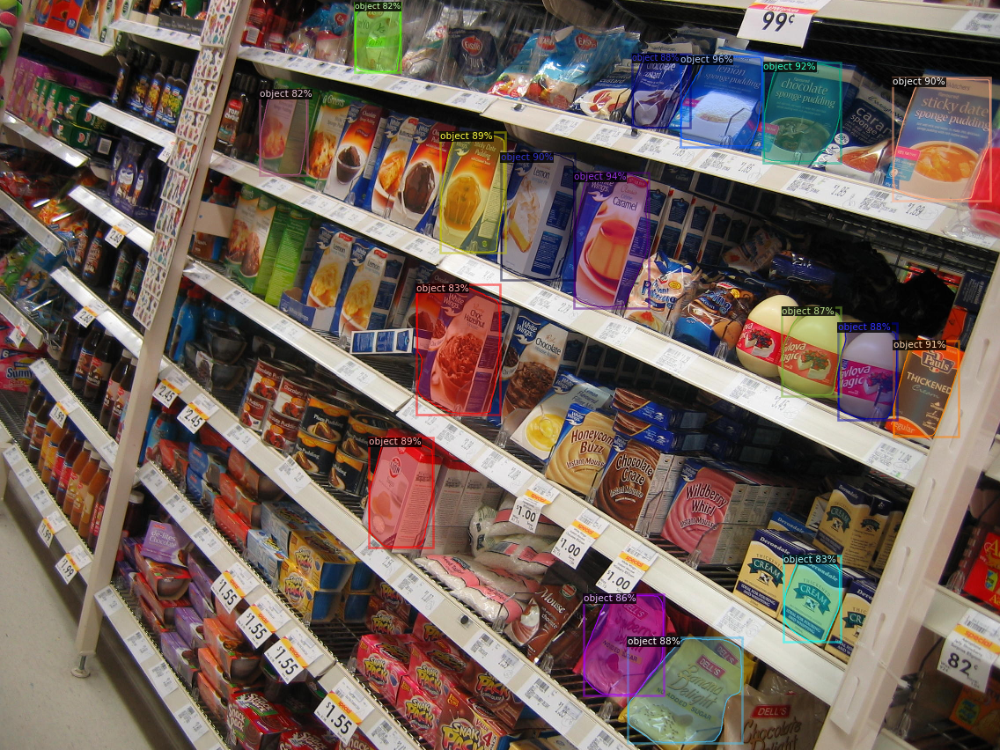

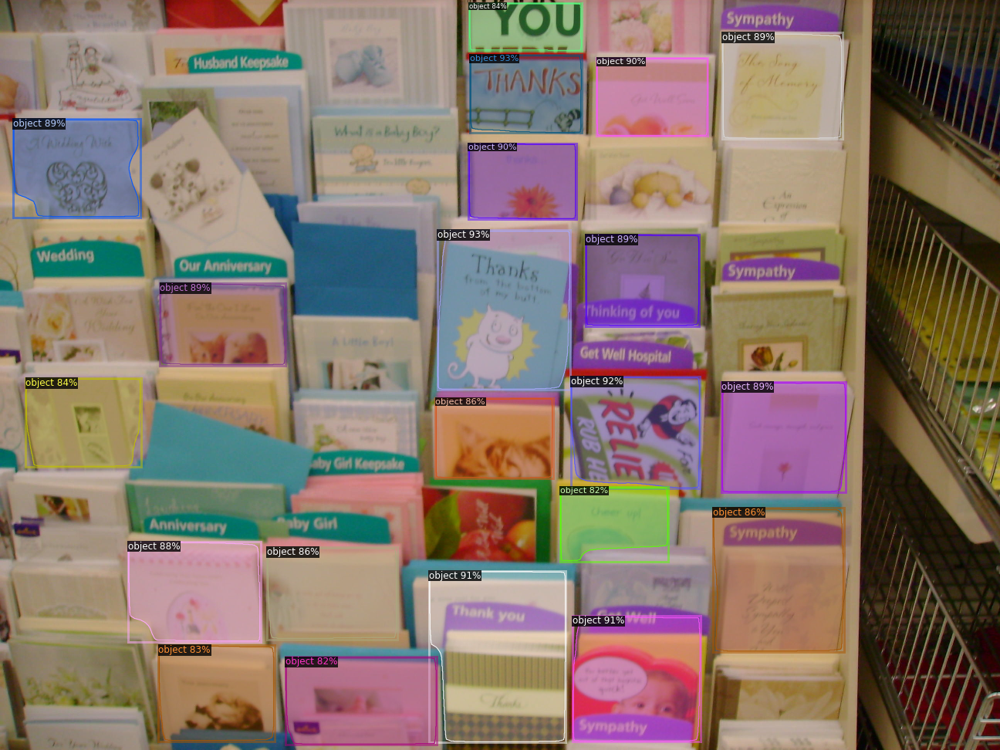

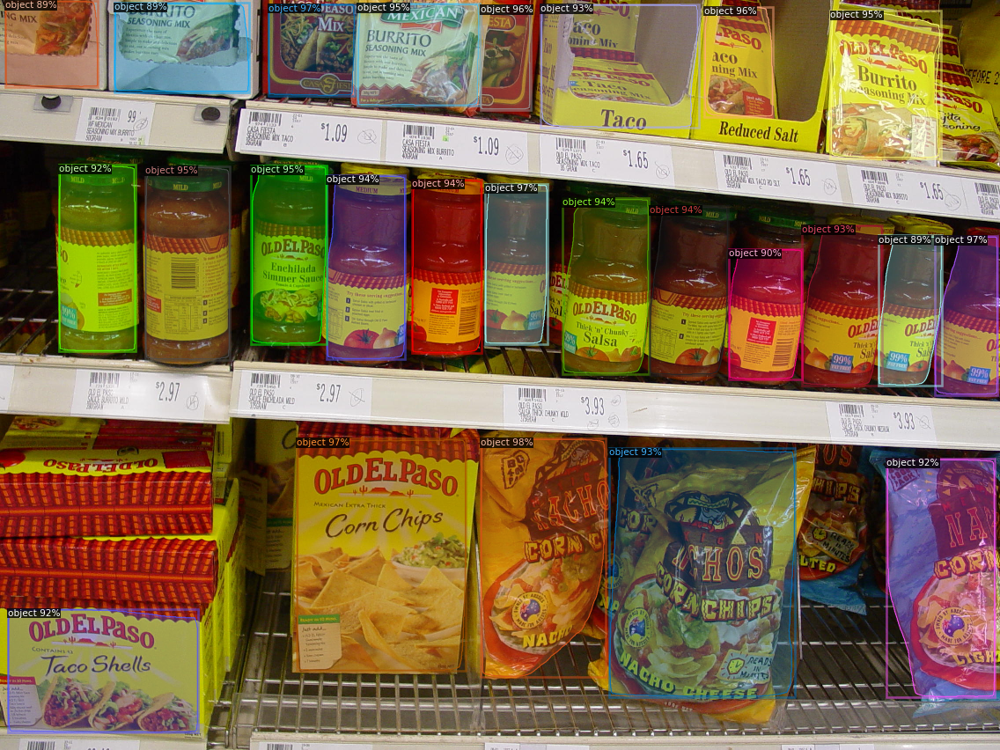

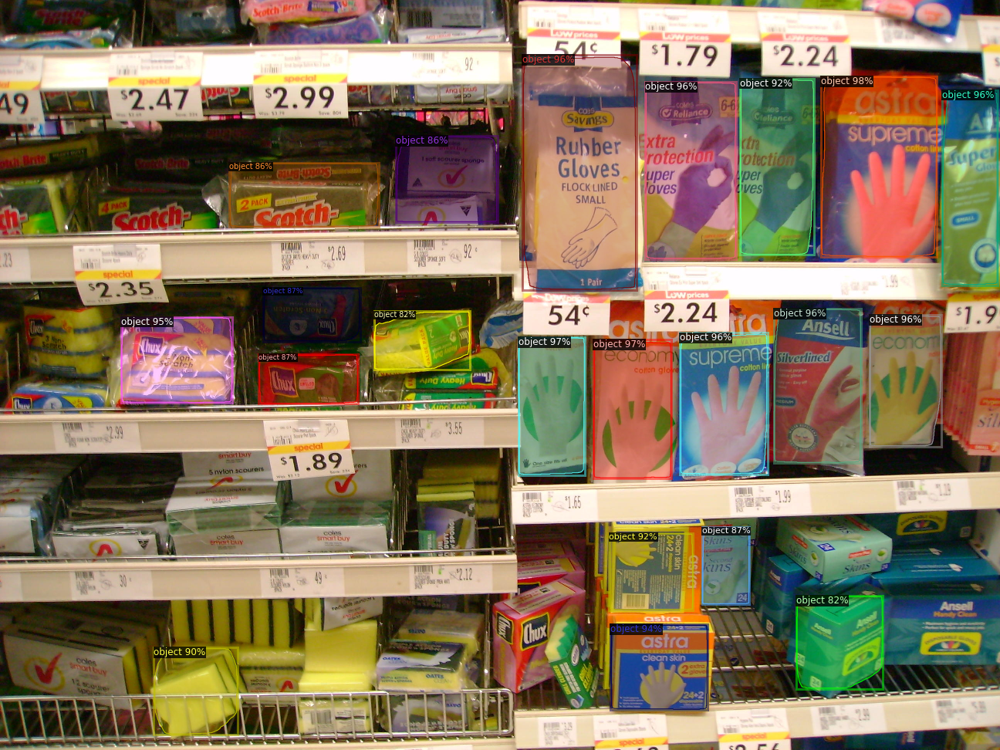

In [45]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = create_dataset_dicts(test_df, classes)
for d in random.sample(dataset_dicts, 10):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  
    v = Visualizer(im[:, :, ::-1],
                   metadata=statement_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

 **Inferencing on test set
and
Storing the result**

In [46]:
evaluator = COCOEvaluator("objects_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "objects_val")
inference_on_dataset(trainer.model, val_loader, evaluator)


WARNING [02/17 13:48:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[02/17 13:48:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[02/17 13:48:38 d2.data.common]: Serializing 316 elements to byte tensors and concatenating them all ...
[02/17 13:48:38 d2.data.common]: Serialized dataset takes 0.77 MiB
[02/17 13:48:38 d2.evaluation.evaluator]: Start inference on 316 batches
[02/17 13:49:29 d2.evaluation.evaluator]: Inference done 11/316. Dataloading: 0.0020 s/iter. Inference: 0.9237 s/iter. Eval: 3.9604 s/iter. Total: 4.8861 s/iter. ETA=0:24:50
[02/17 13:49:40 d2.evaluation.evaluator]: Inference done 14/316. Dataloading: 0.0025 s/iter. Inference: 0.9159 s/iter. Eval: 3.6124 s/iter. Total: 4.5312 s/iter. ETA=0:22:48
[02/17 13:49:46 d2.evaluation.evaluator]: Inference done 1

OrderedDict([('bbox',
              {'AP': 43.891320977048416,
               'AP50': 82.5051168588222,
               'AP75': 42.55343215423889,
               'APl': 45.02449521306376,
               'APm': 7.8443921078351115,
               'APs': 0.0}),
             ('segm',
              {'AP': 43.03383706667903,
               'AP50': 82.5164677655975,
               'AP75': 40.63288141371576,
               'APl': 44.19026798552366,
               'APm': 7.566444156512797,
               'APs': 0.0})])

In [47]:
os.makedirs("annotated_results", exist_ok=True)
test_image_paths = test_df.file_path.unique()

In [48]:
for test_image in test_image_paths:
  im = cv2.imread(test_image)
  outputs = predictor(im)
  v = Visualizer(
    im[:, :, ::-1],
    metadata=statement_metadata, 
    scale=0.5, 
    instance_mode=ColorMode.IMAGE_BW
  )
  instances = outputs["instances"].to("cpu")
  v = v.draw_instance_predictions(instances)
  result = v.get_image()[:, :, ::-1]
  file_name = ntpath.basename(test_image)
  write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

In [49]:
!ls annotated_results

db1013.jpg  db1530.jpg	db1969.jpg  db2663.jpg	db3072.jpg  db633.jpg
db1028.jpg  db1535.jpg	db1984.jpg  db2666.jpg	db3075.jpg  db638.jpg
db1032.jpg  db1537.jpg	db2007.jpg  db2667.jpg	db3076.jpg  db642.jpg
db1050.jpg  db1542.jpg	db2023.jpg  db2676.jpg	db309.jpg   db648.jpg
db1055.jpg  db1545.jpg	db2028.jpg  db2681.jpg	db3107.jpg  db679.jpg
db1070.jpg  db1550.jpg	db2035.jpg  db2683.jpg	db3119.jpg  db682.jpg
db1078.jpg  db1570.jpg	db2044.jpg  db2693.jpg	db311.jpg   db691.jpg
db1081.jpg  db1575.jpg	db2070.jpg  db26.jpg	db3121.jpg  db724.jpg
db1086.jpg  db1588.jpg	db2077.jpg  db2706.jpg	db3124.jpg  db732.jpg
db1089.jpg  db1590.jpg	db207.jpg   db2716.jpg	db313.jpg   db745.jpg
db10.jpg    db1598.jpg	db2090.jpg  db2722.jpg	db3144.jpg  db746.jpg
db1100.jpg  db1605.jpg	db2094.jpg  db2729.jpg	db333.jpg   db747.jpg
db1111.jpg  db1620.jpg	db2141.jpg  db2731.jpg	db335.jpg   db74.jpg
db1113.jpg  db162.jpg	db2145.jpg  db2742.jpg	db345.jpg   db750.jpg
db1114.jpg  db163.jpg	db2190.jpg  db2751.jpg	db363.j

In [50]:
annotated_images = [f'annotated_results/{f}' for f in test_df.image_name.unique()]

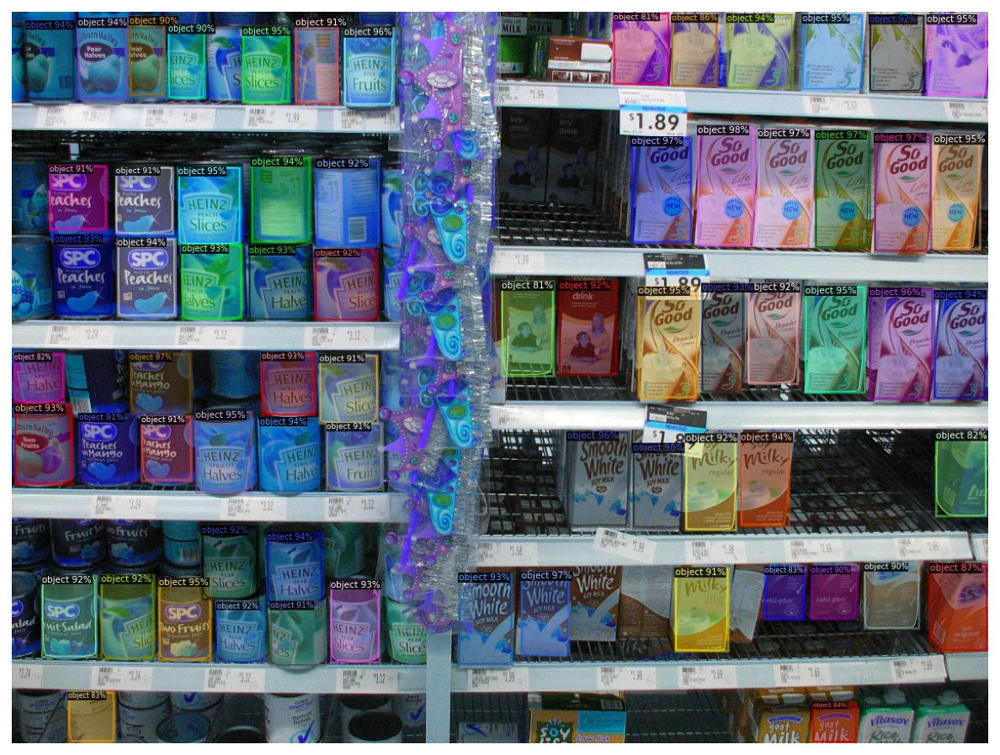

In [66]:
img = cv2.imread(annotated_images[178])

plt.imshow(img)
plt.axis('off');



In [2]:
random_sample = random.sample(annotated_images, 1)
imgg = cv2.imread(random_sample[0])

plt.imshow(imgg)
plt.axis('off');

### this will take random image from annoted images and show me the output

NameError: ignored